In [1]:
!nvidia-smi

Tue May 21 10:30:27 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:D8:00.0 Off |                  Off |
| N/A   32C    P0    26W / 150W |      0MiB / 32768MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [11]:
def load_json_gz_files(data_dir):
    examples = []
    files = [os.path.join(data_dir, fn) for fn in os.listdir(data_dir) if fn.endswith('.json.gz')][0:5]
    
    for fn in files:
        print(f"Processing file: {fn}")
        with gzip.open(fn, mode="rt", encoding="utf-8") as f:
            for line in f:
                row = json.loads(line)
                examples.append({
                    "id": row["id"],
                    "text": row["text"],
                    "added": row.get("added", ""),
                    "created": row.get("created", ""),
                    "source": row.get("source", "")
                })
    
    return examples
examples = load_json_gz_files(data_dir)


Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0092.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0079.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0013.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0080.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0085.json.gz


In [32]:
from transformers import AutoModel, AutoTokenizer

def load_local_model(model_name_or_path):
    """
    Load a Hugging Face Transformers model and tokenizer from a local path.
    
    Args:
    model_name_or_path (str): Path to the local directory containing the model and tokenizer files.
    
    Returns:
    model, tokenizer: The loaded model and tokenizer.
    """
    # Load the tokenizer
    tokenizer = AutoTokenizer.from_pretrained(model_name_or_path)
    # Load the model
    model = AutoModel.from_pretrained(model_name_or_path)
    
    return model, tokenizer

In [31]:
a=examples[10]['text']
a,len(a)

('Software engineering at the speed of light: how developers stay current using twitter\n\nThe microblogging service Twitter has over 500 million users posting over 500 million tweets daily. Research has established that software developers use Twitter in their work, but this has not yet been examined in detail. Twitter is an important medium in some software engineering circles—understanding its use could lead to improved support, and learning more about the reasons for non-adoption could inform the design of improved tools. In a qualitative study, we surveyed 271 and interviewed 27 developers active on GitHub. We find that Twitter helps them keep up with the fast-paced development landscape. They use it to stay aware of industry changes, for learning, and for building relationships. We discover the challenges they experience and extract their coping strategies. Some developers do not want to or cannot embrace Twitter for their work—we show their reasons and alternative channels. We v

In [9]:
import os
import gzip
import json
from datasets import Dataset, DatasetDict

def load_json_gz_files(data_dir):
    examples = []
    files = [os.path.join(data_dir, fn) for fn in os.listdir(data_dir) if fn.endswith('.json.gz')]
    
    for fn in files:
        print(f"Processing file: {fn}")
        with gzip.open(fn, mode="rt", encoding="utf-8") as f:
            for line in f:
                row = json.loads(line)
                examples.append({
                    "id": row["id"],
                    "text": row["text"],
                    "added": row.get("added", ""),
                    "created": row.get("created", ""),
                    "source": row.get("source", "")
                })
    
    return examples

def create_dataset(data_dir):
    examples = load_json_gz_files(data_dir)
    
    # Define the features of the dataset
    features = {
        "id": datasets.Value("string"),
        "text": datasets.Value("string"),
        "added": datasets.Value("string"),
        "created": datasets.Value("string"),
        "source": datasets.Value("string"),
    }

    # Create Dataset
    dataset = Dataset.from_pandas(pd.DataFrame(examples), features=features)
    
    return dataset

# Usage
data_dir = "../../Datasets/dolma_v1.6_sample"
dataset = create_dataset(data_dir)
print(dataset)


Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0092.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0079.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0013.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0080.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0085.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0020.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0069.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0087.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0008.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0062.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0058.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0097.json.gz
Processing file: ../../Datasets/dolma_v1.6_sample/v1_5r2_sample-0066.json.gz

NameError: name 'datasets' is not defined

ValueError: Loading dolma_edited requires you to execute the dataset script in that repo on your local machine. Make sure you have read the code there to avoid malicious use, then set the option `trust_remote_code=True` to remove this error.

NameError: name 'dataset' is not defined

In [ ]:
import transformers

print(transformers.__version__)

In [1]:
#import installed libraries

import sys
from fancy_einsum import einsum

import transformer_lens.utils as utils
from transformer_lens.hook_points import (
    HookPoint,
)  # Hooking utilities
from transformers import AutoTokenizer, pipeline, logging, AutoModelForCausalLM, AutoConfig
from transformer_lens import ActivationCache, HookedTransformer

from huggingface_hub import notebook_login
from datasets import Dataset
import pandas as pd
import transformers
import torch
import einops  # Make sure einops is imported
import numpy as np 

from neel_plotly import line, imshow, scatter
import transformer_lens.patching as patching
import circuitsvis as cv
import matplotlib.pyplot as plt
from pathlib import Path

In [3]:
# Import from local libraries

from load_HookedTransformer import load_HookedTransformer
from utils import *
from datasets import load_dataset
from load_Datasets import load_and_concat_openwebtext

In [ ]:
import torch
import torch.nn as nn

# Define vocabulary size
vocab_size = 10000  # Example vocabulary size, you can change it

# Create embedding layers
embedding_5000 = nn.Embedding(vocab_size, 5000)
embedding_500 = nn.Embedding(vocab_size, 500)

# Calculate the number of parameters
params_5000 = sum(p.numel() for p in embedding_5000.parameters())
params_500 = sum(p.numel() for p in embedding_500.parameters())

# Print the number of parameters
print(f"Number of parameters with embedding dimension 5000: {params_5000}")
print(f"Number of parameters with embedding dimension 500: {params_500}")

# Calculate and print the reduction factor
reduction_factor = params_5000 / params_500
print(f"Reduction factor: {reduction_factor}")


Number of parameters with embedding dimension 5000: 50000000
Number of parameters with embedding dimension 500: 5000000
Reduction factor: 10.0


In [4]:
torch.set_grad_enabled(False)
#model,tokenizer = load_HookedTransformer('llama-7b')
model,tokenizer = load_HookedTransformer('gpt2-small')

In [5]:
subset=[0]
dataset = load_and_concat_openwebtext(subset)

In [6]:

def get_last_index(tokens, pad_token_index = 50256):
    max_len=tokens.shape[1]
    tokens=tokens[:,1:].cpu()
    
    # Create a boolean mask where the condition is True for the pad_token_index
    pad_mask = (tokens == pad_token_index)

    # However, argmax returns 0 for rows where the condition is never True (i.e., no pad_token_index found).
    # To distinguish between cases where the pad_token_index is at the start (index 0) and not present, 
    # we can use a trick: multiply the mask by a range tensor and use argmax on that.
    # If the pad token is not present in the row, the result will be 0 for that row, since the mask will be all False.

    # Generate a range tensor of the same shape as prompts
    last_index = pad_mask.int().argmax(dim=1)
    last_index[last_index==0]=max_len-1
    
    return last_index.numpy()

'''
tokens=model.to_tokens(dataset.iloc[:1000].text)
text_lengths=get_last_index(tokens)
text_lengths
plt.hist(get_last_index(prompts)+1)

# Add labels and title
plt.xlabel('Text Length')
plt.ylabel('Frequency')
plt.title('Distribution of Text Lengths')

# Show plot
plt.show()
'''

"\ntokens=model.to_tokens(dataset.iloc[:1000].text)\ntext_lengths=get_last_index(tokens)\ntext_lengths\nplt.hist(get_last_index(prompts)+1)\n\n# Add labels and title\nplt.xlabel('Text Length')\nplt.ylabel('Frequency')\nplt.title('Distribution of Text Lengths')\n\n# Show plot\nplt.show()\n"

In [14]:
project_name = 'final_activation_gpt2_set0_ctx_1024'
if not os.path.exists(project_name):
    os.mkdir(project_name)
    print(f"Directory '{project_name}' created.")
else:
    print(f"Directory '{project_name}' already exists.")

import os
import torch
from pathlib import Path

num_samples = 10
batch_size = 5
ctx_len=1024

model.cfg.n_ctx=ctx_len

# Initialize dictionaries to hold final activations for both sets of positions
final_activations = {
    'last0': {}, 'last1': {}, 'last2': {}, 'last3': {}, 'last10': {}, 'last20': {}, 
    'pos0': {}, 'pos5': {}, 'pos10': {}, 'pos50': {}
}

target_keys_substrings = [
    "hook_attn_out",
    "hook_mlp_out",
    "hook_resid_pre",
    "hook_resid_mid",
    "hook_resid_post",
    "ln_final"
]

layer_indices = [0, 1, 2, 3, 5, 7, 9, 10, 11]
target_layers_substrings = [f"blocks.{index}" for index in layer_indices] + ["ln_final"]

# Define specific token positions

names_filter= [key for key in list(model.hook_dict.keys()) if any(substring in key for substring in target_keys_substrings)]
names_filter= [key for key in names_filter if any(substring in key for substring in target_layers_substrings)]

last_token_positions=[0,1,2,3,10,20]
token_positions = [0, 5, 10, 50]  
last_idxs=[]

for i in range(int(np.ceil(num_samples // batch_size))):
    prompts = dataset.iloc[batch_size * i : min(batch_size * (i + 1), num_samples)].text
    
    tokens=model.to_tokens(prompts.tolist())
    #tokens = torch.concatenate([t[:ctx_len] for t in tokens])
    tokens=tokens[:,:ctx_len]
    last_idx = get_last_index(tokens, pad_token_index=50256)
    _, cache = model.run_with_cache(tokens, names_filter=names_filter)

    # Process each key in the cache
    for key in cache.keys():
        if any(substring in key for substring in target_keys_substrings):

            if hasattr(cache[key], 'shape') and len(cache[key].shape) == 3:
                # Process for last positions relative to last_idx
                for offset, suffix in zip(last_token_positions, ['last0', 'last1', 'last2', 'last3', 'last10', 'last20']):
                    position = -offset
                    slices = [cache[key][j, last_idx[j] + position, :].cpu() for j in range(len(last_idx)) if last_idx[j] + position >= 0]
                    if slices:
                        if key not in final_activations[suffix]:
                            final_activations[suffix][key] = []
                        final_activations[suffix][key].extend(slices)

                # Process for specific token positions
                for position in token_positions:
                    if tokens.shape[1] > position:  # Ensure sequence is long enough
                        slices = [cache[key][j, position, :].cpu() for j in range(tokens.shape[0]) if tokens.shape[1] > position]
                        if slices:
                            suffix = f'pos{position}'
                            if key not in final_activations[suffix]:
                                final_activations[suffix][key] = []
                            final_activations[suffix][key].extend(slices)
    last_idxs=last_idxs+list(last_idx)
    del _
    del cache
    del tokens
    torch.cuda.empty_cache()
    print(f"{batch_size * (i + 1) - 1}th samples done")

# Save the extracted slices
for suffix in final_activations.keys():
    for key, value in final_activations[suffix].items():
        if value:  # Check if there are tensors to save
            tensor_stack = torch.stack(value, dim=0)
            torch.save(tensor_stack, Path(project_name) / f'{key}.{suffix}.pt')
            
            
torch.save(last_idxs, Path(project_name) / 'last_idxs.pt')

Directory 'final_activation_gpt2_set0_ctx_1024' already exists.


KeyboardInterrupt: 

In [13]:
pad_token_index=tokenizer.pad_token_id
pad_token_index

In [9]:
    max_len=tokens.shape[1]
    tokens=tokens[:,1:].cpu()
    
    # Create a boolean mask where the condition is True for the pad_token_index
    pad_mask = (tokens == pad_token_index)

    # However, argmax returns 0 for rows where the condition is never True (i.e., no pad_token_index found).
    # To distinguish between cases where the pad_token_index is at the start (index 0) and not present, 
    # we can use a trick: multiply the mask by a range tensor and use argmax on that.
    # If the pad token is not present in the row, the result will be 0 for that row, since the mask will be all False.

    # Generate a range tensor of the same shape as prompts
    last_index = pad_mask.int().argmax(dim=1)
    last_index[last_index==0]=max_len-1
    

NameError: name 'pad_token_index' is not defined

In [36]:
'''
project_name='final_activation_gpt2_test'
if not os.path.exists(project_name):
    os.mkdir(project_name)
    print(f"Directory '{project_name}' created.")
else:
    print(f"Directory '{project_name}' already exists.")
    

num_samples = 20
batch_size = 12

activation_tensors_last0=[]; activation_tensors_last1=[]; activation_tensors_last2=[]; activation_tensors_last3=[];
last_idxs=[]

for i in range(num_samples//batch_size+1):
    prompts = dataset.iloc[batch_size*i:min(batch_size*(i+1),num_samples)].text
    
    tokens = model.to_tokens(prompts, prepend_bos=True)
    last_idx=get_last_index(tokens)

    original_logits, cache = model.run_with_cache(tokens)

    #target_token = model.to_tokens(target_word, prepend_bos=False)

    activation_tensor_of_interest_last0=[cache["ln_final.hook_normalized"][j,last_idx[j],:].cpu() for j in range(tokens.shape[0])]
    activation_tensor_of_interest_last1=[cache["ln_final.hook_normalized"][j,last_idx[j]-1,:].cpu() for j in range(tokens.shape[0])]
    activation_tensor_of_interest_last2=[cache["ln_final.hook_normalized"][j,last_idx[j]-2,:].cpu() for j in range(tokens.shape[0])]
    activation_tensor_of_interest_last3=[cache["ln_final.hook_normalized"][j,last_idx[j]-3,:].cpu() for j in range(tokens.shape[0])]

    last_idxs=last_idxs+list(last_idx)
    activation_tensors_last0 = activation_tensors_last0 + activation_tensor_of_interest_last0
    activation_tensors_last1 = activation_tensors_last1 + activation_tensor_of_interest_last1
    activation_tensors_last2 = activation_tensors_last2 + activation_tensor_of_interest_last0
    activation_tensors_last3 = activation_tensors_last3 + activation_tensor_of_interest_last1
    del original_logits
    #del cache
    del tokens
    torch.cuda.empty_cache()
    print(f"{batch_size*(i+1)-1}th samples done")
    
# Step 3: Convert the list to a tensor stack if it's not empty
if activation_tensors_last0:
    activation_tensors_last0 = torch.stack(activation_tensors_last0,dim=0)
    activation_tensors_last1 = torch.stack(activation_tensors_last1,dim=0)
    activation_tensors_last2 = torch.stack(activation_tensors_last2,dim=0)
    activation_tensors_last3 = torch.stack(activation_tensors_last3,dim=0)
else:
    print("No activation tensors collected.")
    
# Assuming activation_tensors is your tensor
torch.save(activation_tensors_last0, Path(project_name) / 'activation_tensors_last0.pt')
torch.save(activation_tensors_last1, Path(project_name) / 'activation_tensors_last1.pt')
torch.save(activation_tensors_last2, Path(project_name) / 'activation_tensors_last2.pt')
torch.save(activation_tensors_last3, Path(project_name) / 'activation_tensors_last3.pt')

torch.save(last_idxs, Path(project_name) / 'last_idxs.pt')
'''

Directory 'final_activation_gpt2_test' already exists.
11th samples done


OutOfMemoryError: CUDA out of memory. Tried to allocate 384.00 MiB. GPU 0 has a total capacty of 31.74 GiB of which 20.88 MiB is free. Including non-PyTorch memory, this process has 31.71 GiB memory in use. Of the allocated memory 30.65 GiB is allocated by PyTorch, and 178.51 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [23]:
from sklearn.neighbors import NearestNeighbors
from sklearn import linear_model
# Method to calculate ID

def get_ratios(vectors, n_neighbors):
    try:
        N = len(vectors)
        nbrs = NearestNeighbors(n_neighbors=n_neighbors, algorithm="auto").fit(vectors)
        distances, indices = nbrs.kneighbors(vectors)
        ratios = np.array(
            [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
        )

    except Exception as e:
        print(f"An error occurred: {e}")
        ratios = None
        N = 0

    return ratios, N


def measure_dimension_kNN(
    vectors, n_neighbors=5, fraction=0.9, plot=False, verbose=False
):
    ratios, N = get_ratios(vectors, n_neighbors)
    try:
        mus = [
            np.sort(ratios[i], axis=None, kind="quicksort") for i in range(n_neighbors - 2)
        ]
        Femp = (np.arange(1, N + 1, dtype=np.float64)) / N

        dims = []
        xs = []
        ys = []
        for k, mu in enumerate(mus):
            x = np.log(mu[:-2])
            xs += [x]
            y = -np.log(1 - Femp[:-2] ** (1 / (k + 1)))
            ys += [y]

            npoints = int(np.floor(N * fraction))
            regr = linear_model.LinearRegression(fit_intercept=False)
            regr.fit(x[:npoints, np.newaxis], y[:npoints, np.newaxis])
            if verbose:
                print(
                    "From ratio " + str(k + 2) + " NN estimated dim " + str(regr.coef_[0])
                )
            dims += [regr.coef_[0]]

        if plot:
            fig, ax = plt.subplots(figsize=(7, 7))
            ax.set_title("Log F vs Log mu")
            ax.set_xscale("linear")
            ax.set_yscale("linear")
            for x, y, dim in zip(xs, ys, dims):
                ax.scatter(x[:npoints], y[:npoints])
                ax.plot(
                    x[:npoints], regr.predict(x[:npoints].reshape((-1, 1))), color="gray"
                )
                ax.text(x[0],y[0], f'Dim {dim}', fontsize=14, color='blue')
        #print(x[:npoints],regr.predict(x[:npoints].reshape((-1, 1)) ))
        return xs, ys, dims, fig
    except:
        return None, None, None, None


def measure_dimension_MLE(vectors, n_neighbors=10, plot=False, verbose=False):
    ratios, _ = get_ratios(vectors, n_neighbors)
    logs = np.log(ratios)
    estimates = (n_neighbors - 2) / (logs[:, -1] - np.sum(logs[:, :-1], axis=1))
    dim = np.mean(estimates)
    var = np.var(estimates)
    if verbose:
        print("Dimension MLE: ", dim, " Stddev: ", np.sqrt(var))
    if plot:
        fig, axs = plt.subplots(1, 1)
        axs.hist(estimates, bins=50)

    return dim, var, estimates

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [19.69242702]
From ratio 3 NN estimated dim [23.88301945]
From ratio 4 NN estimated dim [28.20481804]
From ratio 2 NN estimated dim [23.50354632]
From ratio 3 NN estimated dim [26.43384528]
From ratio 4 NN estimated dim [29.02630706]
From ratio 2 NN estimated dim [19.86574824]
From ratio 3 NN estimated dim [26.44841025]
From ratio 4 NN estimated dim [32.20893478]
From ratio 2 NN estimated dim [50.37703761]
From ratio 3 NN estimated dim [55.97421654]
From ratio 4 NN estimated dim [60.44281955]
From ratio 2 NN estimated dim [20.41597897]
From ratio 3 NN estimated dim [23.57127271]
From ratio 4 NN estimated dim [25.6756264]
From ratio 2 NN estimated dim [62.37538114]
From ratio 3 NN estimated dim [94.01120004]
From ratio 4 NN estimated dim [112.53462788]
From ratio 2 NN estimated dim [18.05940618]
From ratio 3 NN estimated dim [24.1078268]
From ratio 4 NN estimated dim [30.35688776]
From ratio 2 NN estimated dim [58.62172994]
From ratio 3 NN estimated dim [69

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [35.25250714]
From ratio 3 NN estimated dim [28.0186298]
From ratio 4 NN estimated dim [27.68603584]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [28.07119583]
From ratio 3 NN estimated dim [31.07544887]
From ratio 4 NN estimated dim [33.43919622]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [17.94182176]
From ratio 3 NN estimated dim [22.12507215]
From ratio 4 NN estimated dim [25.08539622]
From ratio 2 NN estimated dim [22.7154495]
From ratio 3 NN estimated dim [24.81427048]
From ratio 4 NN estimated dim [25.85465591]
From ratio 2 NN estimated dim [21.14744065]
From ratio 3 NN estimated dim [24.13716791]
From ratio 4 NN estimated dim [26.22487327]
From ratio 2 NN estimated dim [24.80201594]
From ratio 3 NN estimated dim [27.00386819]
From ratio 4 NN estimated dim [28.97302334]
From ratio 2 NN estimated dim [17.65152135]
From ratio 3 NN estimated dim [22.91771612]
From ratio 4 NN estimated dim [27.82193033]
From ratio 2 NN estimated dim [16.52279204]
From ratio 3 NN estimated dim [23.14272638]
From ratio 4 NN estimated dim [28.39193368]
From ratio 2 NN estimated dim [26.07393886]
From ratio 3 NN estimated dim [28.65649492]
From ratio 4 NN estimated dim [30.13810377]
From ratio 2 NN estimated dim [25.70174585]
From ratio 3 NN estimated dim [27

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:51: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(7, 7))
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [28.2081404]
From ratio 3 NN estimated dim [30.34526328]
From ratio 4 NN estimated dim [32.60270185]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [19.69375804]
From ratio 3 NN estimated dim [21.35202955]
From ratio 4 NN estimated dim [23.46464877]
From ratio 2 NN estimated dim [1.0233861]
From ratio 3 NN estimated dim [1.00174253]
From ratio 4 NN estimated dim [0.98233275]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [37.17438359]
From ratio 3 NN estimated dim [45.29774501]
From ratio 4 NN estimated dim [48.52924405]
From ratio 2 NN estimated dim [1.12921974]
From ratio 3 NN estimated dim [1.0548218]
From ratio 4 NN estimated dim [1.04169515]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [51.52485451]
From ratio 3 NN estimated dim [61.95738931]
From ratio 4 NN estimated dim [64.54519694]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [19.71116869]
From ratio 3 NN estimated dim [28.47528114]
From ratio 4 NN estimated dim [33.26811435]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [21.11510754]
From ratio 3 NN estimated dim [24.9454663]
From ratio 4 NN estimated dim [27.84616234]
From ratio 2 NN estimated dim [17.17530039]
From ratio 3 NN estimated dim [22.97820349]
From ratio 4 NN estimated dim [26.96545261]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [41.90364259]
From ratio 3 NN estimated dim [48.29735317]
From ratio 4 NN estimated dim [52.38993167]
From ratio 2 NN estimated dim [48.62404027]
From ratio 3 NN estimated dim [54.16512639]
From ratio 4 NN estimated dim [58.26320307]
From ratio 2 NN estimated dim [19.01061786]
From ratio 3 NN estimated dim [23.75403823]
From ratio 4 NN estimated dim [26.21767343]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [30.0336261]
From ratio 3 NN estimated dim [29.65106121]
From ratio 4 NN estimated dim [30.62342228]
From ratio 2 NN estimated dim [19.64967296]
From ratio 3 NN estimated dim [23.78486294]
From ratio 4 NN estimated dim [25.87486335]
From ratio 2 NN estimated dim [61.71058506]
From ratio 3 NN estimated dim [76.4183973]
From ratio 4 NN estimated dim [80.05040192]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [47.37870889]
From ratio 3 NN estimated dim [38.20909545]
From ratio 4 NN estimated dim [35.66680392]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [17.89091045]
From ratio 3 NN estimated dim [21.99093988]
From ratio 4 NN estimated dim [24.45582377]
From ratio 2 NN estimated dim [67.04142793]
From ratio 3 NN estimated dim [55.61660874]
From ratio 4 NN estimated dim [54.49256187]
From ratio 2 NN estimated dim [21.72515174]
From ratio 3 NN estimated dim [29.568338]
From ratio 4 NN estimated dim [35.55984942]
From ratio 2 NN estimated dim [52.94738797]
From ratio 3 NN estimated dim [58.72448216]
From ratio 4 NN estimated dim [60.97604928]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [1.08035274]
From ratio 3 NN estimated dim [1.01253719]
From ratio 4 NN estimated dim [1.00079086]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [31.24542191]
From ratio 3 NN estimated dim [26.62651423]
From ratio 4 NN estimated dim [26.4020037]
From ratio 2 NN estimated dim [17.62845712]
From ratio 3 NN estimated dim [25.89307185]
From ratio 4 NN estimated dim [30.14118959]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [19.1185109]
From ratio 3 NN estimated dim [24.14748574]
From ratio 4 NN estimated dim [28.3855575]
From ratio 2 NN estimated dim [43.24254874]
From ratio 3 NN estimated dim [50.30732219]
From ratio 4 NN estimated dim [50.21542192]
From ratio 2 NN estimated dim [20.83241418]
From ratio 3 NN estimated dim [23.81457307]
From ratio 4 NN estimated dim [25.38845345]
From ratio 2 NN estimated dim [67.94968301]
From ratio 3 NN estimated dim [80.25277735]
From ratio 4 NN estimated dim [86.40822769]
From ratio 2 NN estimated dim [23.43434897]
From ratio 3 NN estimated dim [24.91861222]
From ratio 4 NN estimated dim [27.70252936]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [21.492911]
From ratio 3 NN estimated dim [25.71554429]
From ratio 4 NN estimated dim [28.71049581]
From ratio 2 NN estimated dim [23.01096481]
From ratio 3 NN estimated dim [28.3387148]
From ratio 4 NN estimated dim [32.99953643]
From ratio 2 NN estimated dim [28.82722823]
From ratio 3 NN estimated dim [47.22680855]
From ratio 4 NN estimated dim [62.37343693]
From ratio 2 NN estimated dim [35.30573917]
From ratio 3 NN estimated dim [37.42656899]
From ratio 4 NN estimated dim [42.22283236]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [17.31351562]
From ratio 3 NN estimated dim [21.27654344]
From ratio 4 NN estimated dim [23.46162618]
From ratio 2 NN estimated dim [18.69508961]
From ratio 3 NN estimated dim [24.19563667]
From ratio 4 NN estimated dim [28.21145662]
From ratio 2 NN estimated dim [19.5148413]
From ratio 3 NN estimated dim [22.22133644]
From ratio 4 NN estimated dim [23.57052472]
From ratio 2 NN estimated dim [22.02976828]
From ratio 3 NN estimated dim [25.05748378]
From ratio 4 NN estimated dim [26.78461419]
From ratio 2 NN estimated dim [18.29847619]
From ratio 3 NN estimated dim [25.02608354]
From ratio 4 NN estimated dim [28.89333428]
From ratio 2 NN estimated dim [19.79283594]
From ratio 3 NN estimated dim [23.78023416]
From ratio 4 NN estimated dim [26.49891267]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [24.71016198]
From ratio 3 NN estimated dim [28.2700086]
From ratio 4 NN estimated dim [30.40422645]
From ratio 2 NN estimated dim [29.74683488]
From ratio 3 NN estimated dim [30.61951346]
From ratio 4 NN estimated dim [32.28814319]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [21.93912556]
From ratio 3 NN estimated dim [26.90045942]
From ratio 4 NN estimated dim [30.77148361]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [73.3560773]
From ratio 3 NN estimated dim [65.58668308]
From ratio 4 NN estimated dim [67.38516982]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [20.56697498]
From ratio 3 NN estimated dim [21.89929759]
From ratio 4 NN estimated dim [22.97818848]
From ratio 2 NN estimated dim [21.01808277]
From ratio 3 NN estimated dim [24.43168417]
From ratio 4 NN estimated dim [26.19873016]
From ratio 2 NN estimated dim [21.90234922]
From ratio 3 NN estimated dim [24.76806773]
From ratio 4 NN estimated dim [28.35805877]
From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [19.31551041]
From ratio 3 NN estimated dim [23.48971968]
From ratio 4 NN estimated dim [27.4339748]
From ratio 2 NN estimated dim [21.20580995]
From ratio 3 NN estimated dim [26.46947809]
From ratio 4 NN estimated dim [30.51079128]
From ratio 2 NN estimated dim [76.03998359]
From ratio 3 NN estimated dim [76.02076381]
From ratio 4 NN estimated dim [76.28576178]
From ratio 2 NN estimated dim [56.89798499]
From ratio 3 NN estimated dim [76.68445196]
From ratio 4 NN 

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [21.46849174]
From ratio 3 NN estimated dim [26.25383964]
From ratio 4 NN estimated dim [27.31529013]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [20.56697498]
From ratio 3 NN estimated dim [21.89929759]
From ratio 4 NN estimated dim [22.97818848]
From ratio 2 NN estimated dim [20.14317725]
From ratio 3 NN estimated dim [24.49257204]
From ratio 4 NN estimated dim [27.46867029]
From ratio 2 NN estimated dim [19.06938918]
From ratio 3 NN estimated dim [26.48401638]
From ratio 4 NN estimated dim [31.74434964]
From ratio 2 NN estimated dim [33.81418665]
From ratio 3 NN estimated dim [38.42398696]
From ratio 4 NN estimated dim [40.09583361]
From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [57.33791501]
From ratio 3 NN estimated dim [89.16299763]
From ratio 4 NN estimated dim [105.41431307]
From ratio 2 NN estimated dim [0.96992267]
From ratio 3 NN estimated dim [0.95840492]
From ratio 4 NN estimated dim [0.98661438]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [17.6496197]
From ratio 3 NN estimated dim [20.81458767]
From ratio 4 NN estimated dim [21.86029553]
From ratio 2 NN estimated dim [40.85464365]
From ratio 3 NN estimated dim [41.26719859]
From ratio 4 NN estimated dim [44.54136984]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [57.63266938]
From ratio 3 NN estimated dim [72.1092571]
From ratio 4 NN estimated dim [75.2840994]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [26.10248411]
From ratio 3 NN estimated dim [23.97828182]
From ratio 4 NN estimated dim [25.44894436]
From ratio 2 NN estimated dim [57.41985911]
From ratio 3 NN estimated dim [63.80444901]
From ratio 4 NN estimated dim [69.23748475]
From ratio 2 NN estimated dim [15.06588092]
From ratio 3 NN estimated dim [22.4790242]
From ratio 4 NN estimated dim [27.14783996]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [70.17494581]
From ratio 3 NN estimated dim [72.74415812]
From ratio 4 NN estimated dim [75.5373171]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [15.99195268]
From ratio 3 NN estimated dim [19.1438914]
From ratio 4 NN estimated dim [21.31455404]
From ratio 2 NN estimated dim [19.31322214]
From ratio 3 NN estimated dim [19.98321647]
From ratio 4 NN estimated dim [21.02855848]
From ratio 2 NN estimated dim [48.71937378]
From ratio 3 NN estimated dim [49.41296823]
From ratio 4 NN estimated dim [51.89493853]
From ratio 2 NN estimated dim [67.91177294]
From ratio 3 NN estimated dim [85.88676285]
From ratio 4 NN estimated dim [98.46450407]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [24.07730081]
From ratio 3 NN estimated dim [25.08288021]
From ratio 4 NN estimated dim [26.89995584]
From ratio 2 NN estimated dim [21.20580995]
From ratio 3 NN estimated dim [26.46947809]
From ratio 4 NN estimated dim [30.51079128]
From ratio 2 NN estimated dim [50.46748018]
From ratio 3 NN estimated dim [52.06388069]
From ratio 4 NN estimated dim [53.31597808]
From ratio 2 NN estimated dim [16.00672899]
From ratio 3 NN estimated dim [21.13706938]
From ratio 4 NN estimated dim [24.32033789]
From ratio 2 NN estimated dim [50.05887357]
From ratio 3 NN estimated dim [58.9634954]
From ratio 4 NN estimated dim [60.47088427]
From ratio 2 NN estimated dim [55.23715317]
From ratio 3 NN estimated dim [58.96234168]
From ratio 4 NN estimated dim [61.11077269]
From ratio 2 NN estimated dim [62.8605478]
From ratio 3 NN estimated dim [92.62341459]
From ratio 4 NN e

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [58.22233337]
From ratio 3 NN estimated dim [62.88808867]
From ratio 4 NN estimated dim [64.56223775]
From ratio 2 NN estimated dim [28.75791524]
From ratio 3 NN estimated dim [33.32183853]
From ratio 4 NN estimated dim [35.22088804]
From ratio 2 NN estimated dim [60.05974684]
From ratio 3 NN estimated dim [80.91385536]
From ratio 4 NN estimated dim [93.07137308]
From ratio 2 NN estimated dim [16.58795845]
From ratio 3 NN estimated dim [20.10069332]
From ratio 4 NN estimated dim [22.17136409]
From ratio 2 NN estimated dim [46.34014251]
From ratio 3 NN estimated dim [51.75838522]
From ratio 4 NN estimated dim [51.80876757]
From ratio 2 NN estimated dim [21.62320417]
From ratio 3 NN estimated dim [26.13603266]
From ratio 4 NN estimated dim [29.69436399]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [19.15271785]
From ratio 3 NN estimated dim [23.52376344]
From ratio 4 NN estimated dim [26.57718892]
From ratio 2 NN estimated dim [16.52279204]
From ratio 3 NN estimated dim [23.14272638]
From ratio 4 NN estimated dim [28.39193368]
From ratio 2 NN estimated dim [22.06395776]
From ratio 3 NN estimated dim [25.32207024]
From ratio 4 NN estimated dim [27.00886225]
From ratio 2 NN estimated dim [64.02940256]
From ratio 3 NN estimated dim [70.58001128]
From ratio 4 NN estimated dim [74.15474749]
From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [42.57280106]
From ratio 3 NN estimated dim [49.29409592]
From ratio 4 NN estimated dim [51.43587417]
From ratio 2 NN estimated dim [21.83778291]
From ratio 3 NN estimated dim [25.10009702]
From ratio 4 NN estimated dim [27.01971958]
From ratio 2 NN estimated dim [18.74745163]
From ratio 3 NN estimated dim [23.01354908]
From ratio 4 NN

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [31.61473945]
From ratio 3 NN estimated dim [32.24439724]
From ratio 4 NN estimated dim [33.24110601]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [87.83073529]
From ratio 3 NN estimated dim [84.90048449]
From ratio 4 NN estimated dim [82.40139132]
From ratio 2 NN estimated dim [57.43066735]
From ratio 3 NN estimated dim [66.6261174]
From ratio 4 NN estimated dim [69.92140071]
From ratio 2 NN estimated dim [19.84272007]
From ratio 3 NN estimated dim [23.30606154]
From ratio 4 NN estimated dim [25.89382991]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [14.52011516]
From ratio 3 NN estimated dim [17.23848392]
From ratio 4 NN estimated dim [19.47399927]
From ratio 2 NN estimated dim [20.20933193]
From ratio 3 NN estimated dim [26.00362621]
From ratio 4 NN estimated dim [30.5498903]
From ratio 2 NN estimated dim [20.21799327]
From ratio 3 NN estimated dim [27.71581765]
From ratio 4 NN estimated dim [32.8298332]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [91.36528835]
From ratio 3 NN estimated dim [88.88107795]
From ratio 4 NN estimated dim [89.68011833]
From ratio 2 NN estimated dim [22.20089423]
From ratio 3 NN estimated dim [23.79737237]
From ratio 4 NN estimated dim [24.84668568]
From ratio 2 NN estimated dim [58.04166041]
From ratio 3 NN estimated dim [65.43551019]
From ratio 4 NN estimated dim [66.81376561]
From ratio 2 NN estimated dim [19.64967296]
From ratio 3 NN estimated dim [23.78486294]
From ratio 4 NN estimated dim [25.87486335]
From ratio 2 NN estimated dim [19.90493956]
From ratio 3 NN estimated dim [26.82542408]
From ratio 4 NN estimated dim [30.97375128]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [22.68787017]
From ratio 3 NN estimated dim [26.50269351]
From ratio 4 NN estimated dim [27.10696382]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [72.00537373]
From ratio 3 NN estimated dim [81.38640234]
From ratio 4 NN estimated dim [86.52585932]
From ratio 2 NN estimated dim [22.33418695]
From ratio 3 NN estimated dim [24.39653045]
From ratio 4 NN estimated dim [27.13897503]
From ratio 2 NN estimated dim [17.84592822]
From ratio 3 NN estimated dim [19.0573068]
From ratio 4 NN estimated dim [20.54174139]
From ratio 2 NN estimated dim [0.43439258]
From ratio 3 NN estimated dim [0.57110062]
From ratio 4 NN estimated dim [0.67250452]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [22.31146543]
From ratio 3 NN estimated dim [23.68060772]
From ratio 4 NN estimated dim [25.00077817]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [26.10248411]
From ratio 3 NN estimated dim [23.97828182]
From ratio 4 NN estimated dim [25.44894436]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [27.6549964]
From ratio 3 NN estimated dim [26.58496186]
From ratio 4 NN estimated dim [27.66406287]
From ratio 2 NN estimated dim [0.96603281]
From ratio 3 NN estimated dim [0.9614245]
From ratio 4 NN estimated dim [0.96770716]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [41.94153066]
From ratio 3 NN estimated dim [60.23973228]
From ratio 4 NN estimated dim [77.71154086]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [18.91347538]
From ratio 3 NN estimated dim [22.06655698]
From ratio 4 NN estimated dim [23.14275168]
From ratio 2 NN estimated dim [20.42485344]
From ratio 3 NN estimated dim [22.21916804]
From ratio 4 NN estimated dim [22.58204005]
From ratio 2 NN estimated dim [26.90961192]
From ratio 3 NN estimated dim [28.34662857]
From ratio 4 NN estimated dim [31.10682906]
From ratio 2 NN estimated dim [17.31351562]
From ratio 3 NN estimated dim [21.27654344]
From ratio 4 NN estimated dim [23.46162618]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [25.54699061]
From ratio 3 NN estimated dim [27.14017401]
From ratio 4 NN estimated dim [27.5685091]
From ratio 2 NN estimated dim [67.83447289]
From ratio 3 NN estimated dim [82.74568168]
From ratio 4 NN estimated dim [95.31816959]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [18.66123844]
From ratio 3 NN estimated dim [27.80815992]
From ratio 4 NN estimated dim [32.66085267]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [14.17383264]
From ratio 3 NN estimated dim [18.66123354]
From ratio 4 NN estimated dim [20.4583982]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [15.89210797]
From ratio 3 NN estimated dim [20.07296007]
From ratio 4 NN estimated dim [21.69529575]
From ratio 2 NN estimated dim [16.38284296]
From ratio 3 NN estimated dim [22.04416029]
From ratio 4 NN estimated dim [24.89933473]
From ratio 2 NN estimated dim [44.22130467]
From ratio 3 NN estimated dim [47.4005872]
From ratio 4 NN estimated dim [49.04364332]
From ratio 2 NN estimated dim [77.62517687]
From ratio 3 NN estimated dim [80.46402772]
From ratio 4 NN estimated dim [82.33235608]
From ratio 2 NN estimated dim [46.51044786]
From ratio 3 NN estimated dim [49.58921775]
From ratio 4 NN estimated dim [51.63514746]
From ratio 2 NN estimated dim [63.96544149]
From ratio 3 NN estimated dim [88.95650406]
From ratio 4 NN estimated dim [99.86354936]
From ratio 2 NN estimated dim [33.77560947]
From ratio 3 NN estimated dim [38.5636441]
From ratio 4 NN estimated dim [40.18976808]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [27.29795318]
From ratio 3 NN estimated dim [30.61381975]
From ratio 4 NN estimated dim [32.46295947]
From ratio 2 NN estimated dim [29.13758241]
From ratio 3 NN estimated dim [30.94012849]
From ratio 4 NN estimated dim [31.83807454]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [65.95840065]
From ratio 3 NN estimated dim [98.79767389]
From ratio 4 NN estimated dim [115.84667981]
From ratio 2 NN estimated dim [19.46822769]
From ratio 3 NN estimated dim [22.44161776]
From ratio 4 NN estimated dim [25.08612577]
From ratio 2 NN estimated dim [18.66123844]
From ratio 3 NN estimated dim [27.80815992]
From ratio 4 NN estimated dim [32.66085267]
From ratio 2 NN estimated dim [19.68241552]
From ratio 3 NN estimated dim [24.91594042]
From ratio 4 NN estimated dim [27.93670304]
From ratio 2 NN estimated dim [24.79421803]
From ratio 3 NN estimated dim [27.42794695]
From ratio 4 NN estimated dim [30.59732566]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [76.52729729]
From ratio 3 NN estimated dim [67.57313652]
From ratio 4 NN estimated dim [73.49097567]
From ratio 2 NN estimated dim [67.33232388]
From ratio 3 NN estimated dim [72.13366614]
From ratio 4 NN estimated dim [73.96671964]
From ratio 2 NN estimated dim [23.191787]
From ratio 3 NN estimated dim [26.31481944]
From ratio 4 NN estimated dim [25.44748398]
From ratio 2 NN estimated dim [20.21799327]
From ratio 3 NN estimated dim [27.71581765]
From ratio 4 NN estimated dim [32.8298332]
From ratio 2 NN estimated dim [21.0360569]
From ratio 3 NN estimated dim [23.05902696]
From ratio 4 NN estimated dim [23.86045286]
From ratio 2 NN estimated dim [57.03473419]
From ratio 3 NN estimated dim [63.87294127]
From ratio 4 NN estimated dim [72.67721262]
From ratio 2 NN estimated dim [21.46849174]
From ratio 3 NN estimated dim [26.25383964]
From ratio 4 NN estimated dim [27.31529013]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [30.69431922]
From ratio 3 NN estimated dim [29.66207896]
From ratio 4 NN estimated dim [30.82305391]
From ratio 2 NN estimated dim [19.5423768]
From ratio 3 NN estimated dim [21.96918027]
From ratio 4 NN estimated dim [23.45253741]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [46.9707454]
From ratio 3 NN estimated dim [51.577294]
From ratio 4 NN estimated dim [53.44398503]
From ratio 2 NN estimated dim [20.38221011]
From ratio 3 NN estimated dim [23.50285048]
From ratio 4 NN estimated dim [25.24714814]
From ratio 2 NN estimated dim [62.50157326]
From ratio 3 NN estimated dim [78.35476693]
From ratio 4 NN estimated dim [87.50421734]
From ratio 2 NN estimated dim [17.2654258]
From ratio 3 NN estimated dim [22.62218445]
From ratio 4 NN estimated dim [26.81167119]
From ratio 2 NN estimated dim [62.93381883]
From ratio 3 NN estimated dim [73.4119177]
From ratio 4 NN estimated dim [76.24632975]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [1372.35966734]
From ratio 2 NN estimated dim [29.62720753]
From ratio 3 NN estimated dim [31.91770744]
From ratio 4 NN estimated dim [35.05788771]
From ratio 2 NN estimated dim [27.51371073]
From ratio 3 NN estimated dim [28.71913753]
From ratio 4 NN estimated dim [29.79822433]
From ratio 2 NN estimated dim [57.4707711]
From ratio 3 NN estimated dim [61.60116979]
From ratio 4 NN estimated dim [64.47814857]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [29.8125377]
From ratio 3 NN estimated dim [30.6449878]
From ratio 4 NN estimated dim [30.73281438]
From ratio 2 NN estimated dim [21.59240384]
From ratio 3 NN estimated dim [27.3463798]
From ratio 4 NN estimated dim [30.88683478]
From ratio 2 NN estimated dim [55.34458206]
From ratio 3 NN estimated dim [59.71125626]
From ratio 4 NN estimated dim [60.7019228]
From ratio 2 NN estimated dim [20.85782816]
From ratio 3 NN estimated dim [24.56384465]
From ratio 4 NN estimated dim [26.58628459]
From ratio 2 NN estimated dim [34.58241389]
From ratio 3 NN estimated dim [37.82047607]
From ratio 4 NN estimated dim [39.63537749]
From ratio 2 NN estimated dim [42.41104789]
From ratio 3 NN estimated dim [50.01419453]
From ratio 4 NN estimated dim [55.46128319]
From ratio 2 NN estimated dim [20.72070634]
From ratio 3 NN estimated dim [23.20354329]
From ratio 4 NN estimated dim [25.91612248]
From ratio 2 NN estimated dim [22.392736]
From ratio 3 NN estimated dim [27.6444

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [21.70851732]
From ratio 3 NN estimated dim [20.43469623]
From ratio 4 NN estimated dim [22.07369137]
From ratio 2 NN estimated dim [26.10716842]
From ratio 3 NN estimated dim [29.01971514]
From ratio 4 NN estimated dim [29.73435415]
From ratio 2 NN estimated dim [20.53637575]
From ratio 3 NN estimated dim [22.98885003]
From ratio 4 NN estimated dim [24.16224789]
From ratio 2 NN estimated dim [0.99510016]
From ratio 3 NN estimated dim [0.97824249]
From ratio 4 NN estimated dim [1.01577287]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [20.20933193]
From ratio 3 NN estimated dim [26.00362621]
From ratio 4 NN estimated dim [30.5498903]
From ratio 2 NN estimated dim [52.27187769]
From ratio 3 NN estimated dim [56.72068109]
From ratio 4 NN estimated dim [59.66158066]
From ratio 2 NN estimated dim [58.88610068]
From ratio 3 NN estimated dim [67.9686245]
From ratio 4 NN estimated dim [68.18233111]
From ratio 2 NN estimated dim [22.41882339]
From ratio 3 NN estimated dim [27.0893265]
From ratio 4 NN estimated dim [31.67342428]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [23.55665414]
From ratio 3 NN estimated dim [27.65918172]
From ratio 4 NN estimated dim [29.99558065]
From ratio 2 NN estimated dim [23.55665414]
From ratio 3 NN estimated dim [27.65918172]
From ratio 4 NN estimated dim [29.99558065]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [17.93384493]
From ratio 3 NN estimated dim [24.68552473]
From ratio 4 NN estimated dim [28.80397432]
From ratio 2 NN estimated dim [49.50058941]
From ratio 3 NN estimated dim [58.22858465]
From ratio 4 NN estimated dim [60.47529751]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [18.45167517]
From ratio 3 NN estimated dim [21.4121148]
From ratio 4 NN estimated dim [23.28656626]
From ratio 2 NN estimated dim [25.49586461]
From ratio 3 NN estimated dim [27.33559118]
From ratio 4 NN estimated dim [28.69485064]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [27.56651805]
From ratio 3 NN estimated dim [47.57021608]
From ratio 4 NN estimated dim [64.10330061]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [76.1145855]
From ratio 3 NN estimated dim [70.75386341]
From ratio 4 NN estimated dim [68.80630041]
From ratio 2 NN estimated dim [60.9027156]
From ratio 3 NN estimated dim [95.19365069]
From ratio 4 NN estimated dim [114.0110367]
From ratio 2 NN estimated dim [21.11510754]
From ratio 3 NN estimated dim [24.9454663]
From ratio 4 NN estimated dim [27.84616234]
From ratio 2 NN estimated dim [28.24823893]
From ratio 3 NN estimated dim [29.58460304]
From ratio 4 NN estimated dim [31.39870335]
From ratio 2 NN estimated dim [18.09809544]
From ratio 3 NN estimated dim [26.85775089]
From ratio 4 NN estimated dim [31.54325294]
From ratio 2 NN estimated dim [15.85312129]
From ratio 3 NN estimated dim [19.95034766]
From ratio 4 NN estimated dim [22.20190299]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [25.518477]
From ratio 3 NN estimated dim [24.32461123]
From ratio 4 NN estimated dim [25.34933065]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [14.52011516]
From ratio 3 NN estimated dim [17.23848392]
From ratio 4 NN estimated dim [19.47399927]
From ratio 2 NN estimated dim [22.7564019]
From ratio 3 NN estimated dim [30.94731906]
From ratio 4 NN estimated dim [35.40342128]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [28.22119601]
From ratio 3 NN estimated dim [23.89630659]
From ratio 4 NN estimated dim [24.97666908]
From ratio 2 NN estimated dim [24.160028]
From ratio 3 NN estimated dim [28.24610125]
From ratio 4 NN estimated dim [29.08470635]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [24.37179565]
From ratio 3 NN estimated dim [26.01571432]
From ratio 4 NN estimated dim [27.54666378]
From ratio 2 NN estimated dim [19.02891441]
From ratio 3 NN estimated dim [20.69950668]
From ratio 4 NN estimated dim [23.21294152]
From ratio 2 NN estimated dim [19.91955426]
From ratio 3 NN estimated dim [22.74034329]
From ratio 4 NN estimated dim [24.03278887]
From ratio 2 NN estimated dim [22.87502155]
From ratio 3 NN estimated dim [25.42819412]
From ratio 4 NN estimated dim [29.51400095]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [43.64812676]
From ratio 3 NN estimated dim [49.78046397]
From ratio 4 NN estimated dim [53.28208159]
From ratio 2 NN estimated dim [36.88577861]
From ratio 3 NN estimated dim [39.70030307]
From ratio 4 NN estimated dim [42.96649456]
From ratio 2 NN estimated dim [53.83334185]
From ratio 3 NN estimated dim [58.98395095]
From ratio 4 NN estimated dim [61.79859345]
From ratio 2 NN estimated dim [19.90636736]
From ratio 3 NN estimated dim [26.74777323]
From ratio 4 NN estimated dim [32.99638443]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [28.88161941]
From ratio 3 NN estimated dim [25.87321055]
From ratio 4 NN estimated dim [25.33968908]
From ratio 2 NN estimated dim [52.24992741]
From ratio 3 NN estimated dim [56.38868658]
From ratio 4 NN estimated dim [60.43640539]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [22.68787017]
From ratio 3 NN estimated dim [26.50269351]
From ratio 4 NN estimated dim [27.10696382]
From ratio 2 NN estimated dim [37.00460227]
From ratio 3 NN estimated dim [41.17168861]
From ratio 4 NN estimated dim [43.3447283]
From ratio 2 NN estimated dim [105.69236279]
From ratio 3 NN estimated dim [114.96350724]
From ratio 4 NN estimated dim [121.67477504]
From ratio 2 NN estimated dim [20.33191398]
From ratio 3 NN estimated dim [24.14342093]
From ratio 4 NN estimated dim [27.09381176]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [26.34092307]
From ratio 3 NN estimated dim [28.86942692]
From ratio 4 NN estimated dim [29.75803025]
From ratio 2 NN estimated dim [23.87746124]
From ratio 3 NN estimated dim [26.06696679]
From ratio 4 NN estimated dim [27.95576825]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [19.21302566]
From ratio 3 NN estimated dim [21.55770683]
From ratio 4 NN estimated dim [23.75299403]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [18.88675379]
From ratio 3 NN estimated dim [22.40831492]
From ratio 4 NN estimated dim [24.71631435]
From ratio 2 NN estimated dim [17.00164661]
From ratio 3 NN estimated dim [20.41003813]
From ratio 4 NN estimated dim [21.90909542]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [19.29150876]
From ratio 3 NN estimated dim [22.83710616]
From ratio 4 NN estimated dim [25.53612296]
From ratio 2 NN estimated dim [23.34948246]
From ratio 3 NN estimated dim [28.75939002]
From ratio 4 NN estimated dim [32.6805456]
From ratio 2 NN estimated dim [28.67320387]
From ratio 3 NN estimated dim [31.35440237]
From ratio 4 NN estimated dim [31.26166919]
From ratio 2 NN estimated dim [25.16092141]
From ratio 3 NN estimated dim [27.0584852]
From ratio 4 NN estimated dim [28.55172426]
From ratio 2 NN estimated dim [20.32972431]
From ratio 3 NN estimated dim [23.33537485]
From ratio 4 NN estimated dim [26.0590221]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [16.34144299]
From ratio 3 NN estimated dim [18.72856833]
From ratio 4 NN estimated dim [21.18417895]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [28.84164772]
From ratio 3 NN estimated dim [27.95653581]
From ratio 4 NN estimated dim [29.47665538]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [34.44827079]
From ratio 3 NN estimated dim [55.09631571]
From ratio 4 NN estimated dim [72.51693237]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [19.66030821]
From ratio 3 NN estimated dim [23.60640997]
From ratio 4 NN estimated dim [24.2325969]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [22.35728729]
From ratio 3 NN estimated dim [25.43247665]
From ratio 4 NN estimated dim [26.79655776]
From ratio 2 NN estimated dim [26.90968681]
From ratio 3 NN estimated dim [28.34633036]
From ratio 4 NN estimated dim [28.96151421]
From ratio 2 NN estimated dim [25.42928208]
From ratio 3 NN estimated dim [26.68667327]
From ratio 4 NN estimated dim [28.78173111]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [41.04714971]
From ratio 3 NN estimated dim [46.15728402]
From ratio 4 NN estimated dim [46.86015485]
From ratio 2 NN estimated dim [50.03938963]
From ratio 3 NN estimated dim [52.88445391]
From ratio 4 NN estimated dim [54.48033161]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [28.88161941]
From ratio 3 NN estimated dim [25.87321055]
From ratio 4 NN estimated dim [25.33968908]
From ratio 2 NN estimated dim [22.53367344]
From ratio 3 NN estimated dim [23.53822357]
From ratio 4 NN estimated dim [25.9539616]
From ratio 2 NN estimated dim [23.03918369]
From ratio 3 NN estimated dim [24.39072612]
From ratio 4 NN estimated dim [25.00044081]
From ratio 2 NN estimated dim [17.62845712]
From ratio 3 NN estimated dim [25.89307185]
From ratio 4 NN estimated dim [30.14118959]
From ratio 2 NN estimated dim [19.95062531]
From ratio 3 NN estimated dim [26.00518169]
From ratio 4 NN estimated dim [31.04186684]
From ratio 2 NN estimated dim [48.34026241]
From ratio 3 NN estimated dim [51.38881705]
From ratio 4 NN estimated dim [53.78657342]
From ratio 2 NN estimated dim [46.01625469]
From ratio 3 NN estimated dim [50.93439132]
From ratio 4 NN estimated dim [52.79806895]
From ratio 2 NN estimated dim [22.54037616]
From ratio 3 NN estimated dim [25

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [22.09637619]
From ratio 3 NN estimated dim [28.97865167]
From ratio 4 NN estimated dim [33.1621132]
From ratio 2 NN estimated dim [17.37240435]
From ratio 3 NN estimated dim [21.52596675]
From ratio 4 NN estimated dim [22.44884359]
From ratio 2 NN estimated dim [16.00672899]
From ratio 3 NN estimated dim [21.13706938]
From ratio 4 NN estimated dim [24.32033789]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [25.518477]
From ratio 3 NN estimated dim [24.32461123]
From ratio 4 NN estimated dim [25.34933065]
From ratio 2 NN estimated dim [56.61934321]
From ratio 3 NN estimated dim [57.50669962]
From ratio 4 NN estimated dim [58.67287438]
From ratio 2 NN estimated dim [23.29000061]
From ratio 3 NN estimated dim [27.89167855]
From ratio 4 NN estimated dim [29.25274083]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [45.73753047]
From ratio 3 NN estimated dim [47.92956211]
From ratio 4 NN estimated dim [50.54399002]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [17.81838252]
From ratio 3 NN estimated dim [21.72242331]
From ratio 4 NN estimated dim [23.50483588]
From ratio 2 NN estimated dim [45.18116763]
From ratio 3 NN estimated dim [46.60174277]
From ratio 4 NN estimated dim [49.58492423]
From ratio 2 NN estimated dim [45.05373871]
From ratio 3 NN estimated dim [55.90062532]
From ratio 4 NN estimated dim [60.16091322]
From ratio 2 NN estimated dim [21.03448585]
From ratio 3 NN estimated dim [28.55010254]
From ratio 4 NN estimated dim [34.9782013]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [21.06519893]
From ratio 3 NN estimated dim [22.43979897]
From ratio 4 NN estimated dim [23.95743809]
From ratio 2 NN estimated dim [25.60529471]
From ratio 3 NN estimated dim [29.50108812]
From ratio 4 NN estimated dim [30.74414431]
From ratio 2 NN estimated dim [38.13072176]
From ratio 3 NN estimated dim [41.5320295]
From ratio 4 NN estimated dim [43.36884795]
From ratio 2 NN estimated dim [41.27345938]
From ratio 3 NN estimated dim [45.55729536]
From ratio 4 NN estimated dim [47.60812111]
From ratio 2 NN estimated dim [58.45156058]
From ratio 3 NN estimated dim [75.59927063]
From ratio 4 NN estimated dim [83.7878268]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [18.04339294]
From ratio 3 NN estimated dim [19.83770573]
From ratio 4 NN estimated dim [21.91169086]
From ratio 2 NN estimated dim [22.66918281]
From ratio 3 NN estimated dim [29.3850518]
From ratio 4 NN estimated dim [33.30856503]
From ratio 2 NN estimated dim [17.36020139]
From ratio 3 NN estimated dim [24.72337711]
From ratio 4 NN estimated dim [29.93903963]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [19.19407664]
From ratio 3 NN estimated dim [21.23025675]
From ratio 4 NN estimated dim [22.90422518]
From ratio 2 NN estimated dim [24.96731625]
From ratio 3 NN estimated dim [25.15475895]
From ratio 4 NN estimated dim [26.36296133]
From ratio 2 NN estimated dim [17.2654258]
From ratio 3 NN estimated dim [22.62218445]
From ratio 4 NN estimated dim [26.81167119]
From ratio 2 NN estimated dim [17.36020139]
From ratio 3 NN estimated dim [24.72337711]
From ratio 4 NN estimated dim [29.93903963]
From ratio 2 NN estimated dim [54.42158489]
From ratio 3 NN estimated dim [64.00841862]
From ratio 4 NN estimated dim [67.47257832]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [14.01914911]
From ratio 3 NN estimated dim [18.15465505]
From ratio 4 NN estimated dim [19.97148356]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [58.41119266]
From ratio 3 NN estimated dim [60.7512048]
From ratio 4 NN estimated dim [66.19813971]
From ratio 2 NN estimated dim [29.24041155]
From ratio 3 NN estimated dim [31.12794599]
From ratio 4 NN estimated dim [35.42162892]
From ratio 2 NN estimated dim [57.55740897]
From ratio 3 NN estimated dim [63.95131967]
From ratio 4 NN estimated dim [68.06702823]
From ratio 2 NN estimated dim [19.90493956]
From ratio 3 NN estimated dim [26.82542408]
From ratio 4 NN estimated dim [30.97375128]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [22.36823265]
From ratio 3 NN estimated dim [24.11189317]
From ratio 4 NN estimated dim [25.7070513]
From ratio 2 NN estimated dim [35.57632556]
From ratio 3 NN estimated dim [42.05373213]
From ratio 4 NN estimated dim [43.61885134]
From ratio 2 NN estimated dim [43.36521405]
From ratio 3 NN estimated dim [58.86168535]
From ratio 4 NN estimated dim [68.15682255]
From ratio 2 NN estimated dim [46.0078856]
From ratio 3 NN estimated dim [48.33597974]
From ratio 4 NN estimated dim [48.95130388]
From ratio 2 NN estimated dim [20.3398155]
From ratio 3 NN estimated dim [23.491238]
From ratio 4 NN estimated dim [26.85162931]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [17.29607295]
From ratio 3 NN estimated dim [21.97680387]
From ratio 4 NN estimated dim [24.31409207]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [59.68551942]
From ratio 3 NN estimated dim [48.33631483]
From ratio 4 NN estimated dim [48.74049434]
From ratio 2 NN estimated dim [62.13086495]
From ratio 3 NN estimated dim [84.96664802]
From ratio 4 NN estimated dim [96.79369391]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [16.38284296]
From ratio 3 NN estimated dim [22.04416029]
From ratio 4 NN estimated dim [24.89933473]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [62.36499936]
From ratio 3 NN estimated dim [68.01814465]
From ratio 4 NN estimated dim [73.06616317]
From ratio 2 NN estimated dim [21.03448585]
From ratio 3 NN estimated dim [28.55010254]
From ratio 4 NN estimated dim [34.9782013]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [39.69722963]
From ratio 3 NN estimated dim [43.43791536]
From ratio 4 NN estimated dim [45.21752713]
From ratio 2 NN estimated dim [24.8176079]
From ratio 3 NN estimated dim [26.37442888]
From ratio 4 NN estimated dim [27.2399194]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [15.68619661]
From ratio 3 NN estimated dim [17.2038734]
From ratio 4 NN estimated dim [19.94184776]
From ratio 2 NN estimated dim [39.95177183]
From ratio 3 NN estimated dim [42.29587563]
From ratio 4 NN estimated dim [45.08550462]
From ratio 2 NN estimated dim [22.36823265]
From ratio 3 NN estimated dim [24.11189317]
From ratio 4 NN estimated dim [25.7070513]
From ratio 2 NN estimated dim [23.10060655]
From ratio 3 NN estimated dim [27.66449762]
From ratio 4 NN estimated dim [34.14948185]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [14.01914911]
From ratio 3 NN estimated dim [18.15465505]
From ratio 4 NN estimated dim [19.97148356]
From ratio 2 NN estimated dim [30.52985357]
From ratio 3 NN estimated dim [53.28823456]
From ratio 4 NN estimated dim [69.7335059]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [25.73993863]
From ratio 3 NN estimated dim [28.47825953]
From ratio 4 NN estimated dim [30.45744946]
From ratio 2 NN estimated dim [43.73837098]
From ratio 3 NN estimated dim [63.66843246]
From ratio 4 NN estimated dim [79.83936952]
From ratio 2 NN estimated dim [20.32972431]
From ratio 3 NN estimated dim [23.33537485]
From ratio 4 NN estimated dim [26.0590221]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [21.70851732]
From ratio 3 NN estimated dim [20.43469623]
From ratio 4 NN estimated dim [22.07369137]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [27.51708721]
From ratio 3 NN estimated dim [24.02692405]
From ratio 4 NN estimated dim [24.79638213]
From ratio 2 NN estimated dim [0.94654766]
From ratio 3 NN estimated dim [0.95543502]
From ratio 4 NN estimated dim [0.98856282]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [17.81838252]
From ratio 3 NN estimated dim [21.72242331]
From ratio 4 NN estimated dim [23.50483588]
From ratio 2 NN estimated dim [17.62425657]
From ratio 3 NN estimated dim [21.20515349]
From ratio 4 NN estimated dim [21.98529842]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [25.42928208]
From ratio 3 NN estimated dim [26.68667327]
From ratio 4 NN estimated dim [28.78173111]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [21.06519893]
From ratio 3 NN estimated dim [22.43979897]
From ratio 4 NN estimated dim [23.95743809]
From ratio 2 NN estimated dim [18.64242367]
From ratio 3 NN estimated dim [27.04249902]
From ratio 4 NN estimated dim [35.15240658]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [15.84746083]
From ratio 3 NN estimated dim [19.57188629]
From ratio 4 NN estimated dim [20.78336576]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [26.92148517]
From ratio 3 NN estimated dim [50.04599149]
From ratio 4 NN estimated dim [64.7120972]
From ratio 2 NN estimated dim [26.06286276]
From ratio 3 NN estimated dim [28.09885205]
From ratio 4 NN estimated dim [28.45787344]
From ratio 2 NN estimated dim [20.63975234]
From ratio 3 NN estimated dim [22.10388597]
From ratio 4 NN estimated dim [23.34465489]
From ratio 2 NN estimated dim [18.01530851]
From ratio 3 NN estimated dim [24.15049774]
From ratio 4 NN estimated dim [28.46094992]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [24.88420614]
From ratio 3 NN estimated dim [26.95938832]
From ratio 4 NN estimated dim [28.73765301]
From ratio 2 NN estimated dim [45.26343549]
From ratio 3 NN estimated dim [55.91159881]
From ratio 4 NN estimated dim [61.89597674]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [27.24031921]
From ratio 3 NN estimated dim [27.10724053]
From ratio 4 NN estimated dim [27.05506373]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [70.79707902]
From ratio 3 NN estimated dim [82.38460957]
From ratio 4 NN estimated dim [85.60785416]
From ratio 2 NN estimated dim [20.0006681]
From ratio 3 NN estimated dim [24.80791951]
From ratio 4 NN estimated dim [28.14979809]
From ratio 2 NN estimated dim [51.94114499]
From ratio 3 NN estimated dim [57.17818995]
From ratio 4 NN estimated dim [62.35685107]
From ratio 2 NN estimated dim [21.10349095]
From ratio 3 NN estimated dim [22.62900517]
From ratio 4 NN estimated dim [24.26937359]
From ratio 2 NN estimated dim [53.34451417]
From ratio 3 NN estimated dim [59.37684734]
From ratio 4 NN estimated dim [61.95554891]
From ratio 2 NN estimated dim [19.79283594]
From ratio 3 NN estimated dim [23.78023416]
From ratio 4 NN estimated dim [26.49891267]
From ratio 2 NN estimated dim [17.13349957]
From ratio 3 NN estimated dim [20.12975292]
From ratio 4 NN 

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [53.16481761]
From ratio 3 NN estimated dim [60.89250986]
From ratio 4 NN estimated dim [63.01543821]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [50.66444629]
From ratio 3 NN estimated dim [48.70632694]
From ratio 4 NN estimated dim [49.11146128]
From ratio 2 NN estimated dim [53.49428525]
From ratio 3 NN estimated dim [61.815986]
From ratio 4 NN estimated dim [67.46627184]
From ratio 2 NN estimated dim [23.09046912]
From ratio 3 NN estimated dim [27.9343491]
From ratio 4 NN estimated dim [32.31297695]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [27.11141302]
From ratio 3 NN estimated dim [26.25731362]
From ratio 4 NN estimated dim [26.62906855]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [24.71016198]
From ratio 3 NN estimated dim [28.2700086]
From ratio 4 NN estimated dim [30.40422645]
From ratio 2 NN estimated dim [72.35003701]
From ratio 3 NN estimated dim [59.24115963]
From ratio 4 NN estimated dim [58.14311843]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [27.12738918]
From ratio 3 NN estimated dim [28.51167086]
From ratio 4 NN estimated dim [30.47780118]
From ratio 2 NN estimated dim [19.31551041]
From ratio 3 NN estimated dim [23.48971968]
From ratio 4 NN estimated dim [27.4339748]
From ratio 2 NN estimated dim [21.31471187]
From ratio 3 NN estimated dim [26.17172054]
From ratio 4 NN estimated dim [28.69009834]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [15.80485042]
From ratio 3 NN estimated dim [19.88742279]
From ratio 4 NN estimated dim [21.7500433]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [14.98412856]
From ratio 3 NN estimated dim [19.44881396]
From ratio 4 NN estimated dim [21.49195476]
From ratio 2 NN estimated dim [52.66741605]
From ratio 3 NN estimated dim [57.24575266]
From ratio 4 NN estimated dim [61.70922181]
From ratio 2 NN estimated dim [18.41852382]
From ratio 3 NN estimated dim [26.59645335]
From ratio 4 NN estimated dim [30.2672345]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [20.78131695]
From ratio 3 NN estimated dim [22.18720503]
From ratio 4 NN estimated dim [23.49084817]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [17.29607295]
From ratio 3 NN estimated dim [21.97680387]
From ratio 4 NN estimated dim [24.31409207]
From ratio 2 NN estimated dim [18.86340578]
From ratio 3 NN estimated dim [24.54549856]
From ratio 4 NN estimated dim [29.06938703]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [17.63349644]
From ratio 3 NN estimated dim [21.43050608]
From ratio 4 NN estimated dim [23.03463006]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [19.91955426]
From ratio 3 NN estimated dim [22.74034329]
From ratio 4 NN estimated dim [24.03278887]
From ratio 2 NN estimated dim [65.25376297]
From ratio 3 NN estimated dim [75.52181518]
From ratio 4 NN estimated dim [77.97640436]
From ratio 2 NN estimated dim [19.5423768]
From ratio 3 NN estimated dim [21.96918027]
From ratio 4 NN estimated dim [23.45253741]
From ratio 2 NN estimated dim [28.98532868]
From ratio 3 NN estimated dim [31.73632676]
From ratio 4 NN estimated dim [33.91175543]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [27.48145252]
From ratio 3 NN estimated dim [25.68690228]
From ratio 4 NN estimated dim [27.55040389]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [29.54833596]
From ratio 3 NN estimated dim [31.88035686]
From ratio 4 NN estimated dim [33.88351978]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [14.17383264]
From ratio 3 NN estimated dim [18.66123354]
From ratio 4 NN estimated dim [20.4583982]
From ratio 2 NN estimated dim [20.38221011]
From ratio 3 NN estimated dim [23.50285048]
From ratio 4 NN estimated dim [25.24714814]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [22.43199634]
From ratio 3 NN estimated dim [24.50561046]
From ratio 4 NN estimated dim [26.50619285]
From ratio 2 NN estimated dim [48.82404235]
From ratio 3 NN estimated dim [46.31580624]
From ratio 4 NN estimated dim [49.01892836]
From ratio 2 NN estimated dim [56.69681544]
From ratio 3 NN estimated dim [57.18010982]
From ratio 4 NN estimated dim [59.86962625]
From ratio 2 NN estimated dim [26.62541035]
From ratio 3 NN estimated dim [32.08784833]
From ratio 4 NN estimated dim [34.47066336]
From ratio 2 NN estimated dim [39.63223667]
From ratio 3 NN estimated dim [48.05198153]
From ratio 4 NN estimated dim [54.85614158]
From ratio 2 NN estimated dim [19.13574745]
From ratio 3 NN estimated dim [22.86092562]
From ratio 4 NN estimated dim [24.7698539]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [33.62462034]
From ratio 3 NN estimated dim [38.80469928]
From ratio 4 NN estimated dim [39.87873934]
From ratio 2 NN estimated dim [26.80718072]
From ratio 3 NN estimated dim [28.03389271]
From ratio 4 NN estimated dim [29.99460456]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [70.06674443]
From ratio 3 NN estimated dim [62.14254205]
From ratio 4 NN estimated dim [64.66920232]
From ratio 2 NN estimated dim [19.15271785]
From ratio 3 NN estimated dim [23.52376344]
From ratio 4 NN estimated dim [26.57718892]
From ratio 2 NN estimated dim [59.43810112]
From ratio 3 NN estimated dim [61.9109498]
From ratio 4 NN estimated dim [64.20388814]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [30.13067155]
From ratio 3 NN estimated dim [26.18044587]
From ratio 4 NN estimated dim [26.65133525]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [28.49644394]
From ratio 3 NN estimated dim [31.443871]
From ratio 4 NN estimated dim [33.37127322]
From ratio 2 NN estimated dim [15.68619661]
From ratio 3 NN estimated dim [17.2038734]
From ratio 4 NN estimated dim [19.94184776]
From ratio 2 NN estimated dim [24.57706824]
From ratio 3 NN estimated dim [27.02154088]
From ratio 4 NN estimated dim [30.09990895]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [97.63801645]
From ratio 3 NN estimated dim [95.26498827]
From ratio 4 NN estimated dim [104.68116892]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [21.83778291]
From ratio 3 NN estimated dim [25.10009702]
From ratio 4 NN estimated dim [27.01971958]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [20.59714736]
From ratio 3 NN estimated dim [21.15042007]
From ratio 4 NN estimated dim [22.418019]
From ratio 2 NN estimated dim [40.04244142]
From ratio 3 NN estimated dim [41.44860969]
From ratio 4 NN estimated dim [43.95443559]
From ratio 2 NN estimated dim [20.14317725]
From ratio 3 NN estimated dim [24.49257204]
From ratio 4 NN estimated dim [27.46867029]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [18.14685507]
From ratio 3 NN estimated dim [25.24675731]
From ratio 4 NN estimated dim [29.4864688]
From ratio 2 NN estimated dim [19.95062531]
From ratio 3 NN estimated dim [26.00518169]
From ratio 4 NN estimated dim [31.04186684]
From ratio 2 NN estimated dim [19.5148413]
From ratio 3 NN estimated dim [22.22133644]
From ratio 4 NN estimated dim [23.57052472]
From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [16.34144299]
From ratio 3 NN estimated dim [18.72856833]
From ratio 4 NN estimated dim [21.18417895]
From ratio 2 NN estimated dim [26.35180937]
From ratio 3 NN estimated dim [32.60583701]
From ratio 4 NN estimated dim [34.77985452]
From ratio 2 NN estimated dim [16.75600823]
From ratio 3 NN estimated dim [23.47333293]
From ratio 4 NN estimated dim [28.49687073]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [21.22592671]
From ratio 3 NN estimated dim [23.95420639]
From ratio 4 NN estimated dim [26.56071398]
From ratio 2 NN estimated dim [30.5431233]
From ratio 3 NN estimated dim [54.2328128]
From ratio 4 NN estimated dim [68.36878788]
From ratio 2 NN estimated dim [51.12005999]
From ratio 3 NN estimated dim [55.5123581]
From ratio 4 NN estimated dim [57.50170345]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [19.19753219]
From ratio 3 NN estimated dim [22.07755825]
From ratio 4 NN estimated dim [23.5025193]
From ratio 2 NN estimated dim [38.79701974]
From ratio 3 NN estimated dim [47.29736958]
From ratio 4 NN estimated dim [48.91620767]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [20.47797131]
From ratio 3 NN estimated dim [23.6384521]
From ratio 4 NN estimated dim [24.08718076]
From ratio 2 NN estimated dim [43.17485056]
From ratio 3 NN estimated dim [49.39773993]
From ratio 4 NN estimated dim [52.21070722]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [24.88420614]
From ratio 3 NN estimated dim [26.95938832]
From ratio 4 NN estimated dim [28.73765301]
From ratio 2 NN estimated dim [19.67860777]
From ratio 3 NN estimated dim [22.01129728]
From ratio 4 NN estimated dim [24.41312113]
From ratio 2 NN estimated dim [20.41597897]
From ratio 3 NN estimated dim [23.57127271]
From ratio 4 NN estimated dim [25.6756264]
From ratio 2 NN estimated dim [21.22592671]
From ratio 3 NN estimated dim [23.95420639]
From ratio 4 NN estimated dim [26.56071398]
From ratio 2 NN estimated dim [41.96233143]
From ratio 3 NN estimated dim [45.83948483]
From ratio 4 NN estimated dim [48.68219146]
From ratio 2 NN estimated dim [54.3632415]
From ratio 3 NN estimated dim [89.17302664]
From ratio 4 NN estimated dim [106.12113693]
From ratio 2 NN estimated dim [22.06395776]
From ratio 3 NN estimated dim [25.32207024]
From ratio 4 NN 

/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [20.90625978]
From ratio 3 NN estimated dim [24.03066102]
From ratio 4 NN estimated dim [26.52941767]
From ratio 2 NN estimated dim [71.71611976]
From ratio 3 NN estimated dim [63.64078399]
From ratio 4 NN estimated dim [60.45090306]
From ratio 2 NN estimated dim [55.08356036]
From ratio 3 NN estimated dim [58.38701961]
From ratio 4 NN estimated dim [61.78077669]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [24.37179565]
From ratio 3 NN estimated dim [26.01571432]
From ratio 4 NN estimated dim [27.54666378]
From ratio 2 NN estimated dim [18.64242367]
From ratio 3 NN estimated dim [27.04249902]
From ratio 4 NN estimated dim [35.15240658]
From ratio 2 NN estimated dim [18.74745163]
From ratio 3 NN estimated dim [23.01354908]
From ratio 4 NN estimated dim [24.45382645]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [30.79041515]
From ratio 3 NN estimated dim [27.91581459]
From ratio 4 NN estimated dim [28.64576685]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [25.56375745]
From ratio 3 NN estimated dim [26.38055477]
From ratio 4 NN estimated dim [26.90424964]
From ratio 2 NN estimated dim [51.16728735]
From ratio 3 NN estimated dim [61.44864848]
From ratio 4 NN estimated dim [63.30486257]
From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]
From ratio 2 NN estimated dim [42.3230623]
From ratio 3 NN estimated dim [47.83280654]
From ratio 4 NN estimated dim [49.34856074]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [29.61406212]
From ratio 3 NN estimated dim [32.35352276]
From ratio 4 NN estimated dim [31.96611052]
From ratio 2 NN estimated dim [42.41308055]
From ratio 3 NN estimated dim [60.10288553]
From ratio 4 NN estimated dim [70.07948054]
From ratio 2 NN estimated dim [68.21895915]
From ratio 3 NN estimated dim [80.70496987]
From ratio 4 NN estimated dim [91.15874473]


/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: divide by zero encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]
/state/partition1/slurm_tmp/25615350.0.0/ipykernel_202339/2861130863.py:11: RuntimeWarning: invalid value encountered in divide
  [distances[:, i] / distances[:, 1] for i in range(2, n_neighbors)]


From ratio 2 NN estimated dim [0.]
From ratio 3 NN estimated dim [0.]
From ratio 4 NN estimated dim [0.]


IsADirectoryError: [Errno 21] Is a directory: 'final_activation_gpt2_set0/.ipynb_checkpoints'

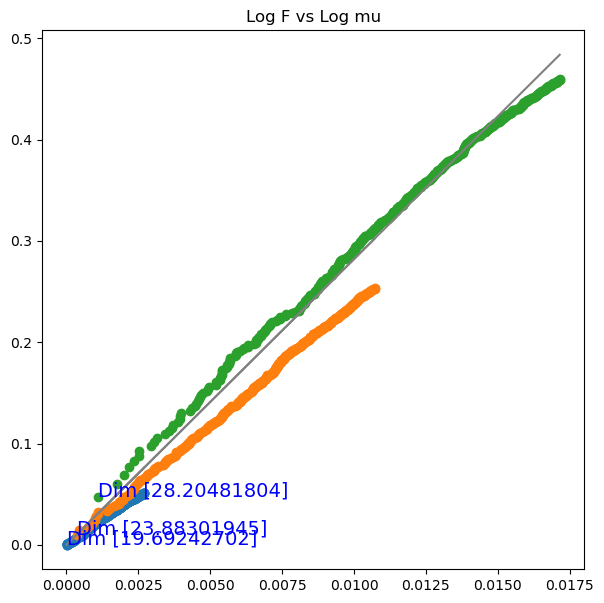

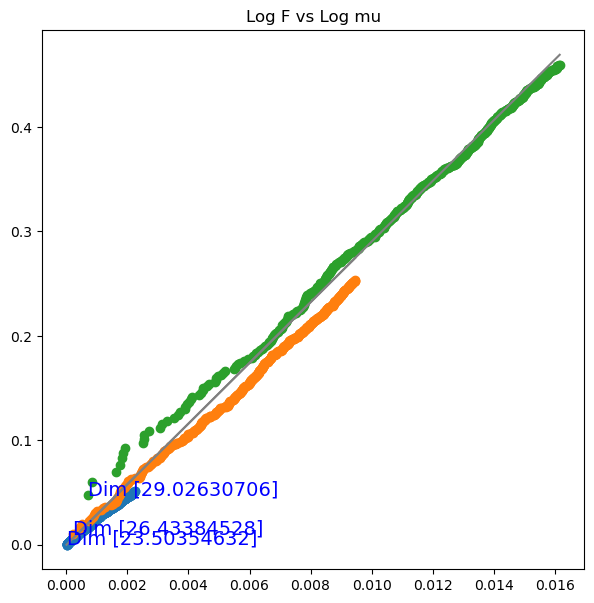

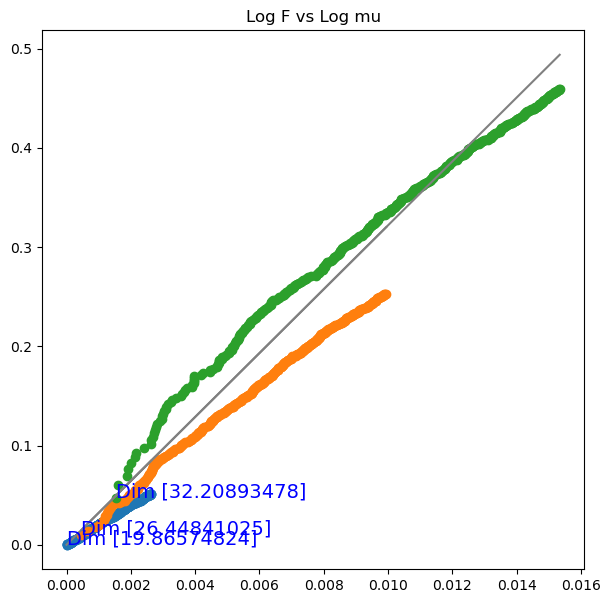

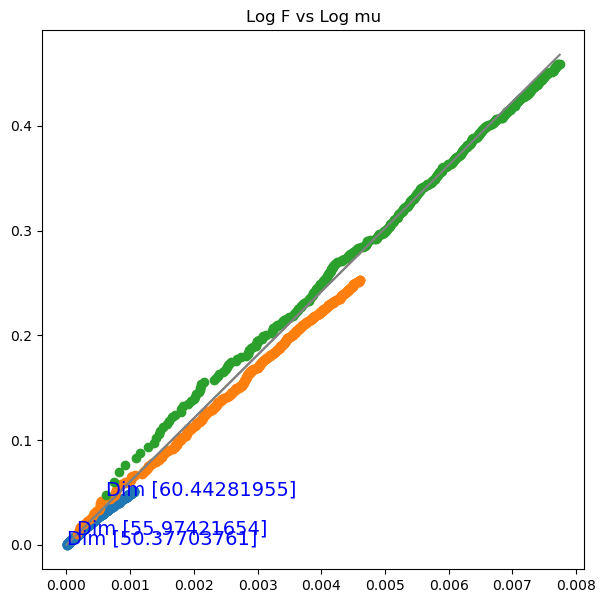

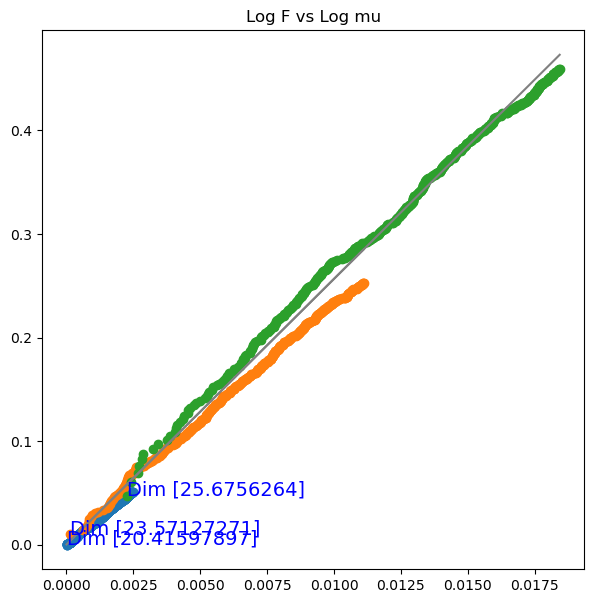

...

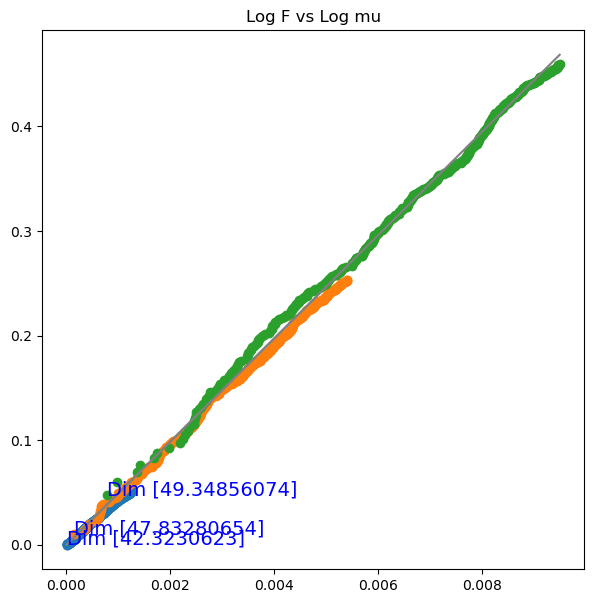

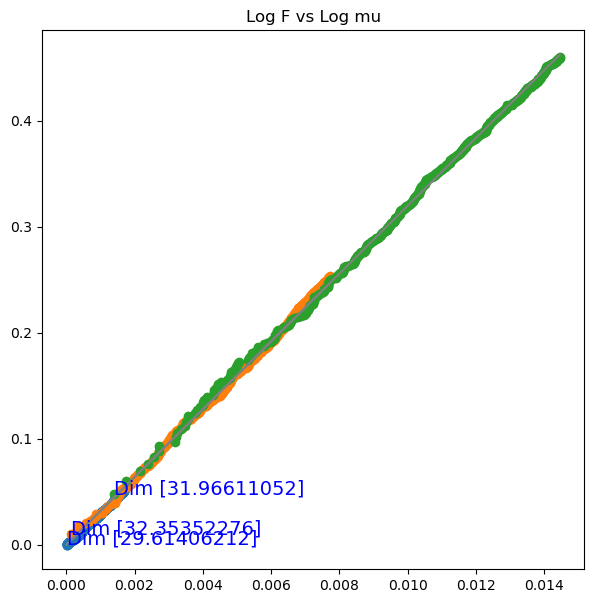

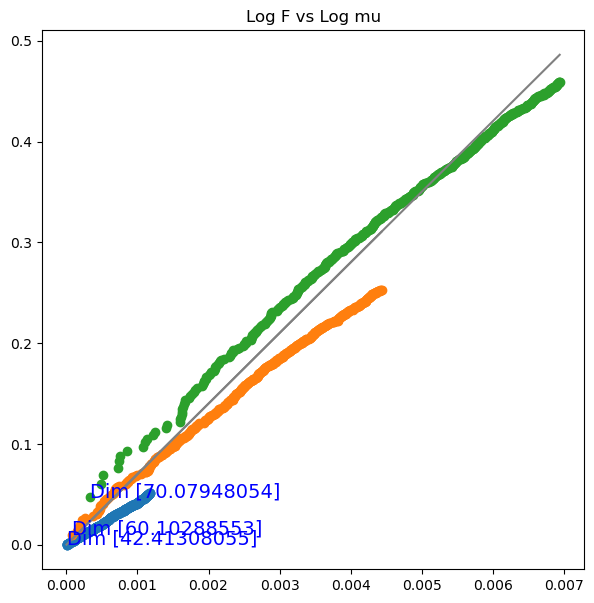

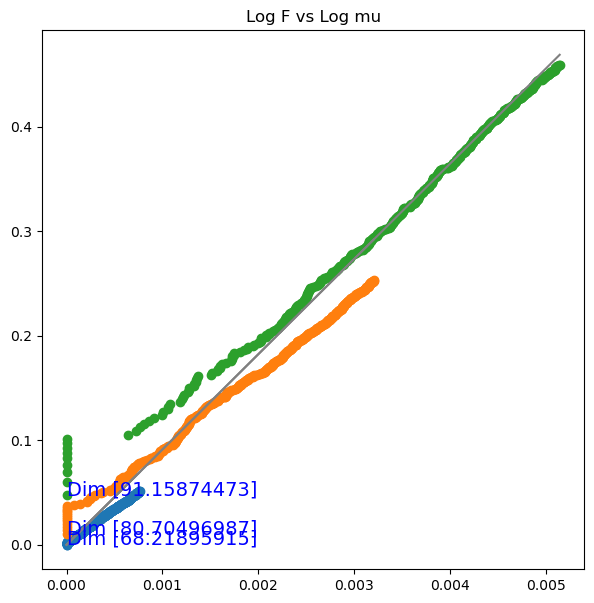

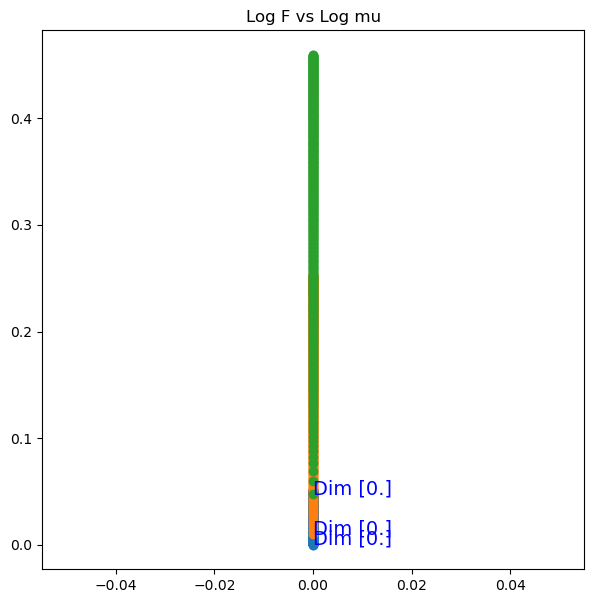

In [35]:
project_name='final_activation_gpt2_set0'
for file in os.listdir(project_name)[:]:
    activation_tensors0 = torch.load(Path(project_name)/file)
    xs, ys, dims, fig = measure_dimension_kNN(activation_tensors0[:10000,:], n_neighbors=5, fraction=0.05, plot=True, verbose=True)
    if fig is not None:
        fig.savefig(Path(project_name) / ('plot_ID_'+file.replace(".pt", ".png")))